**Getting the data from Kaggle**

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"merlijnvanengelen","key":"a733109063493c77c038161c0ec16d2c"}'}

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [ ]:
!kaggle competitions download -c dogs-vs-cats

 97% 790M/812M [00:03<00:00, 215MB/s]
100% 812M/812M [00:03<00:00, 241MB/s]


In [ ]:
!unzip -qq dogs-vs-cats.zip

In [ ]:
!unzip -qq train.zip

**Listing 8.6 Copying images to training, validation, and test directories**

In [ ]:
import os, shutil, pathlib

original_dir = pathlib.Path("train")
new_base_dir = pathlib.Path("cats_vs_dogs_small")

def make_subset(subset_name, start_index, end_index):
    for category in ("cat", "dog"):
      dir = new_base_dir / subset_name / category
      os.makedirs(dir)
      fnames = [f"{category}.{i}.jpg"
                for i in range(start_index, end_index)]
      for fname in fnames:
        shutil.copyfile(src=original_dir / fname,
                                 dst=dir / fname)
make_subset("train", start_index=0, end_index=1000)
make_subset("validation", start_index=1000, end_index=1500)
make_subset("test", start_index=1500, end_index=2500)

**8.2.3 Building the model**

In [ ]:
from tensorflow import keras
from tensorflow.keras import layers

inputs = keras.Input(shape=(180,180,3))
x = layers.Rescaling(1./255)(inputs)
x = layers.Conv2D(filters=32, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=64, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=128, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=256, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=256, kernel_size=3, activation="relu")(x)
x = layers.Flatten()(x)
outputs = layers.Dense(1, activation="sigmoid")(x)

model = keras.Model(inputs=inputs, outputs=outputs)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 180, 180, 3)]     0         
                                                                 
 rescaling (Rescaling)       (None, 180, 180, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 178, 178, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 89, 89, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 87, 87, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 43, 43, 64)       0         
 2D)                                                         

In [ ]:
model.compile(optimizer="rmsprop", loss="binary_crossentropy", metrics=["accuracy"])

**Listing 8.9 Using image_dataset_from_directory to read images**

In [ ]:
from tensorflow.keras.utils import image_dataset_from_directory

train_dataset = image_dataset_from_directory(
    new_base_dir / "train",
    image_size=(180, 180),
    batch_size=32
)
validation_dataset = image_dataset_from_directory(
    new_base_dir / "validation",
    image_size=(180, 180),
    batch_size=32
)
test_dataset = image_dataset_from_directory(
    new_base_dir / "test",
    image_size=(180, 180),
    batch_size=32
)

Found 2000 files belonging to 2 classes.
Found 1000 files belonging to 2 classes.
Found 2000 files belonging to 2 classes.


In [ ]:
for data_batch, labels_batch in train_dataset:
  print("data batch shape:", data_batch.shape)
  print("labels batch shape:", labels_batch.shape)
  break

data batch shape: (32, 180, 180, 3)
labels batch shape: (32,)


**Listing 8.11 Fitting the model using a Dataset**

In [ ]:
callbacks = [
    keras.callbacks.ModelCheckpoint(
        filepath="convnet_from_scratch.keras",
        save_best_only=True,
        monitor="val_loss"
    )
]
history = model.fit(train_dataset, epochs=30, validation_data=validation_dataset, callbacks=callbacks)

Epoch 1/30
63/63 [==============================] - 230s 4s/step - loss: 0.6983 - accuracy: 0.5220 - val_loss: 0.6915 - val_accuracy: 0.5190
Epoch 2/30
63/63 [==============================] - 221s 4s/step - loss: 0.6909 - accuracy: 0.5265 - val_loss: 0.6898 - val_accuracy: 0.5000
Epoch 3/30
63/63 [==============================] - 227s 4s/step - loss: 0.6885 - accuracy: 0.5540 - val_loss: 0.6632 - val_accuracy: 0.5970
Epoch 4/30
63/63 [==============================] - 232s 4s/step - loss: 0.6562 - accuracy: 0.6080 - val_loss: 0.6493 - val_accuracy: 0.6100
Epoch 5/30
63/63 [==============================] - 229s 4s/step - loss: 0.6168 - accuracy: 0.6730 - val_loss: 0.8059 - val_accuracy: 0.5500
Epoch 6/30
63/63 [==============================] - 225s 4s/step - loss: 0.5812 - accuracy: 0.6985 - val_loss: 0.7089 - val_accuracy: 0.6150
Epoch 7/30
63/63 [==============================] - 238s 4s/step - loss: 0.5450 - accuracy: 0.7135 - val_loss: 0.8126 - val_accuracy: 0.6200
Epoch 8/30
63

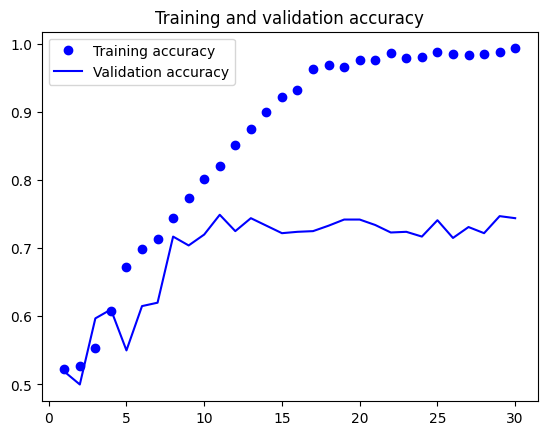

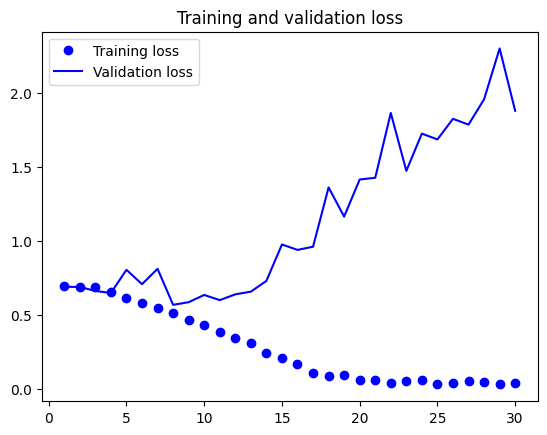

In [ ]:
import matplotlib.pyplot as plt

accuracy = history.history['accuracy']
val_accuracy = history.history["val_accuracy"]
loss = history.history["loss"]
val_loss = history.history['val_loss']

epochs = range(1, len(accuracy) + 1)
plt.plot(epochs, accuracy, "bo", label="Training accuracy")
plt.plot(epochs, val_accuracy, "b", label="Validation accuracy")
plt.title("Training and validation accuracy")
plt.legend()
plt.figure()
plt.plot(epochs, loss, "bo", label="Training loss")
plt.plot(epochs, val_loss, "b", label="Validation loss")
plt.title("Training and validation loss")
plt.legend()
plt.show()

In [ ]:
test_model = keras.models.load_model("convnet_from_scratch.keras")
test_loss, test_acc = test_model.evaluate(test_dataset)
print(f"Accuracy {test_acc:.3f}")

63/63 [==============================] - 54s 852ms/step - loss: 0.5719 - accuracy: 0.7085
Accuracy 0.709


In [ ]:
files.download('convnet_from_scratch.keras')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

*From here on, load the convnet_from_scratch.keras file from google drive when starting Colab again*

In [ ]:
from google.colab import files
files.upload()

Saving convnet_from_scratch.keras to convnet_from_scratch (1).keras


{'convnet_from_scratch.keras': b'\x89HDF\r\n\x1a\n\x00\x00\x00\x00\x00\x08\x08\x00\x04\x00\x10\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\xff\xff\xff\xff\xff\xff\xff\xff\xa8\xb8y\x00\x00\x00\x00\x00\xff\xff\xff\xff\xff\xff\xff\xff\x00\x00\x00\x00\x00\x00\x00\x00`\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x00\x00\x00\x00\x88\x00\x00\x00\x00\x00\x00\x00\xa8\x02\x00\x00\x00\x00\x00\x00\x01\x00\x06\x00\x01\x00\x00\x00\x18\x00\x00\x00\x00\x00\x00\x00\x10\x00\x10\x00\x00\x00\x00\x00 \x03\x00\x00\x00\x00\x00\x00P\x01\x00\x00\x00\x00\x00\x00TREE\x00\x00\x01\x00\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\x00\x00\x00\x00\x00\x00\x00\x00\x00(\x00\x00\x00\x00\x00\x00\x18\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\

In [ ]:
from tensorflow import keras

test_model = keras.models.load_model("convnet_from_scratch.keras")

**Listing 8.14 Define a data augmentation stage to add to an image model**

In [ ]:
from tensorflow.keras import layers

data_augmentation = keras.Sequential(
    [
      layers.RandomFlip("horizontal"),
      layers.RandomRotation(0.1),
      layers.RandomZoom(0.2)
    ]
)

**Listing 8.15 Displaying some randomly augmented training images**

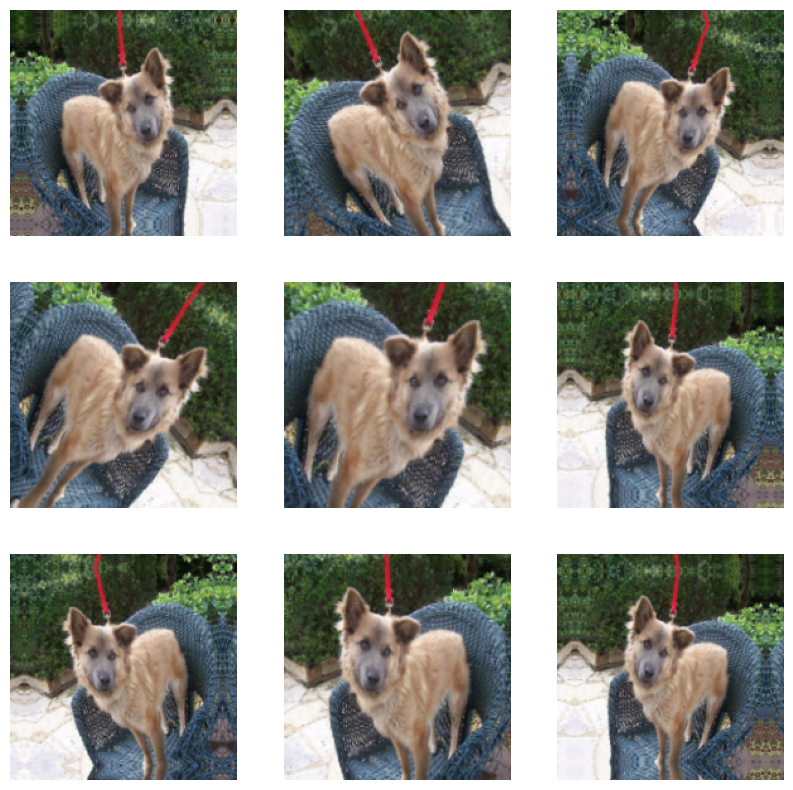

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, _ in train_dataset.take(1):
  for i in range(9):
    augmented_images = data_augmentation(images)
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(augmented_images[0].numpy().astype("uint8"))
    plt.axis("off")

**Listing 8.16 Defining a new convnet that includes image augmentation and dropout**

In [ ]:
inputs = keras.Input(shape=(180, 180, 3))
x = data_augmentation(inputs)
x = layers.Rescaling(1./255)(x)
x = layers.Conv2D(filters=32, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=64, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=128, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=256, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=256, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Flatten()(x)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)

model = keras.Model(inputs=inputs, outputs=outputs)
model.compile(loss="binary_crossentropy", optimizer="rmsprop", metrics=["accuracy"])

In [ ]:
callbacks = [
    keras.callbacks.ModelCheckpoint(
        filepath="convnet_from_scratch_with_augmentation.keras",
        save_best_only=True,
        monitor="val_loss"
    )
]
history = model.fit(
    train_dataset,
    epochs=100,
    validation_data=validation_dataset,
    callbacks=callbacks
)

Epoch 1/100
63/63 [==============================] - 214s 3s/step - loss: 0.6966 - accuracy: 0.4985 - val_loss: 0.6926 - val_accuracy: 0.5000
Epoch 2/100
63/63 [==============================] - 208s 3s/step - loss: 0.6946 - accuracy: 0.5105 - val_loss: 0.6906 - val_accuracy: 0.5000
Epoch 3/100
63/63 [==============================] - 205s 3s/step - loss: 0.6882 - accuracy: 0.5510 - val_loss: 0.6755 - val_accuracy: 0.6080
Epoch 4/100
63/63 [==============================] - 205s 3s/step - loss: 0.6699 - accuracy: 0.6095 - val_loss: 0.7044 - val_accuracy: 0.5050
Epoch 5/100
63/63 [==============================] - 206s 3s/step - loss: 0.6462 - accuracy: 0.6315 - val_loss: 0.9259 - val_accuracy: 0.5110
Epoch 6/100
63/63 [==============================] - 207s 3s/step - loss: 0.6382 - accuracy: 0.6615 - val_loss: 0.6231 - val_accuracy: 0.6380
Epoch 7/100
63/63 [==============================] - 186s 3s/step - loss: 0.6126 - accuracy: 0.6570 - val_loss: 0.5998 - val_accuracy: 0.6670
Epoch 

KeyboardInterrupt: ignored

In [ ]:
files.download("convnet_from_scratch_with_augmentation.keras")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>